In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import sys
sys.path.insert(0, '../..')

In [2]:
import os
import cv2
import torch
from matplotlib import pyplot as plt
from tqdm.autonotebook import tqdm

from detectors.visualizer import Visualizer

def load_image(path):
    img = cv2.imread(path)
    img = torch.as_tensor(img, dtype=torch.float)
    return img

imgs = {filename: load_image(filename) 
        for filename in os.listdir('.')
        if filename.startswith('test') and filename.endswith('.png')}

visualizer = Visualizer()

model_final_f10217.pkl: 178MB [00:08, 20.0MB/s]                              
model_final_a3ec72.pkl: 254MB [00:12, 21.0MB/s]                              
model_final_2d9806.pkl: 431MB [00:19, 21.6MB/s]                              


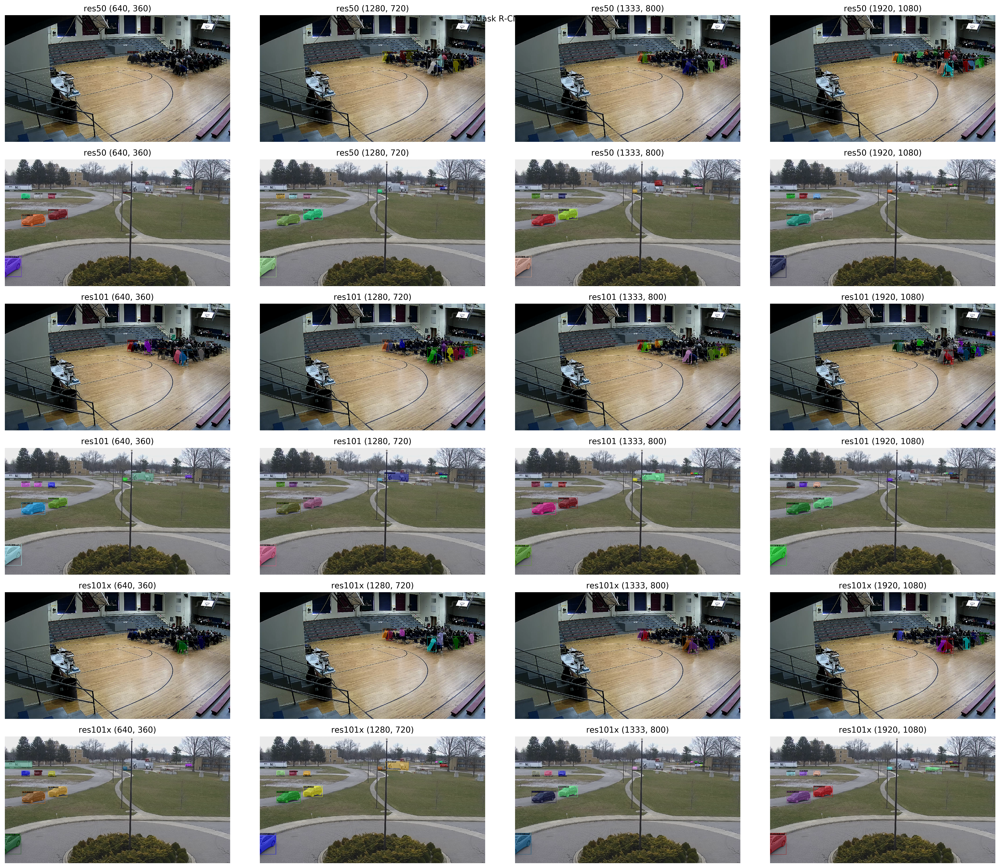

In [3]:
from detectors.mask_rcnn import MaskRCNN

backbones = ['res50', 'res101', 'res101x']
input_shapes = [(640, 360), (1280, 720), (1333, 800), (1920, 1080)]

n_row = len(backbones) * len(imgs)
n_col = len(input_shapes)
fig, axes = plt.subplots(n_row, n_col, figsize=(n_col * 16 / 3, n_row * 9 / 3), dpi=120)
fig.suptitle('Mask R-CNN')
fig.set_tight_layout(0.01)
bar = tqdm(total=n_row * n_col)
for i1, backbone in enumerate(backbones):
    model = MaskRCNN(0, backbone, input_shapes[0])
    for i2, input_shape in enumerate(input_shapes):
        model.cfg.INPUT.MAX_SIZE_TEST = max(input_shape)
        model.cfg.INPUT.MIN_SIZE_TEST = min(input_shape)
        for i3, img in enumerate(imgs.values()):
            detection = model([img])[0]
            visual_image = visualizer.draw(img, detection, show=False)
            ax = axes[i1 * len(imgs) + i3, i2]
            ax.imshow(visual_image)
            ax.set_title('%s %s' % (backbone, input_shape))
            ax.axis('off')
            bar.update()
bar.close()

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      3520  models.common.Focus                     [3, 32, 3]                    
  1             -1  1     18560  models.common.Conv                      [32, 64, 3, 2]                
  2             -1  1     20672  models.common.Bottleneck                [64, 64]                      
  3             -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  4             -1  1    161152  models.common.BottleneckCSP             [128, 128, 3]                 
  5             -1  1    295424  models.common.Conv                      [128, 256, 3, 2]              
  6             -1  1    641792  models.common.BottleneckCSP             [256, 256, 3]                 
  7             -1  1   1180672  models.common.Conv                      [256, 512, 3, 2]              
  8             -1  1    656896  models.common.SPP             

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      5280  models.common.Focus                     [3, 48, 3]                    
  1             -1  1     41664  models.common.Conv                      [48, 96, 3, 2]                
  2             -1  2     92736  models.common.Bottleneck                [96, 96]                      
  3             -1  1    166272  models.common.Conv                      [96, 192, 3, 2]               
  4             -1  1    639168  models.common.BottleneckCSP             [192, 192, 6]                 
  5             -1  1    664320  models.common.Conv                      [192, 384, 3, 2]              
  6             -1  1   2550144  models.common.BottleneckCSP             [384, 384, 6]                 
  7             -1  1   2655744  models.common.Conv                      [384, 768, 3, 2]              
  8             -1  1   1476864  models.common.SPP             

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      7040  models.common.Focus                     [3, 64, 3]                    
  1             -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  2             -1  3    246912  models.common.Bottleneck                [128, 128]                    
  3             -1  1    295424  models.common.Conv                      [128, 256, 3, 2]              
  4             -1  1   1627904  models.common.BottleneckCSP             [256, 256, 9]                 
  5             -1  1   1180672  models.common.Conv                      [256, 512, 3, 2]              
  6             -1  1   6499840  models.common.BottleneckCSP             [512, 512, 9]                 
  7             -1  1   4720640  models.common.Conv                      [512, 1024, 3, 2]             
  8             -1  1   2624512  models.common.SPP             

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      8800  models.common.Focus                     [3, 80, 3]                    
  1             -1  1    115520  models.common.Conv                      [80, 160, 3, 2]               
  2             -1  4    513920  models.common.Bottleneck                [160, 160]                    
  3             -1  1    461440  models.common.Conv                      [160, 320, 3, 2]              
  4             -1  1   3311680  models.common.BottleneckCSP             [320, 320, 12]                
  5             -1  1   1844480  models.common.Conv                      [320, 640, 3, 2]              
  6             -1  1  13228160  models.common.BottleneckCSP             [640, 640, 12]                
  7             -1  1   7375360  models.common.Conv                      [640, 1280, 3, 2]             
  8             -1  1   4099840  models.common.SPP             

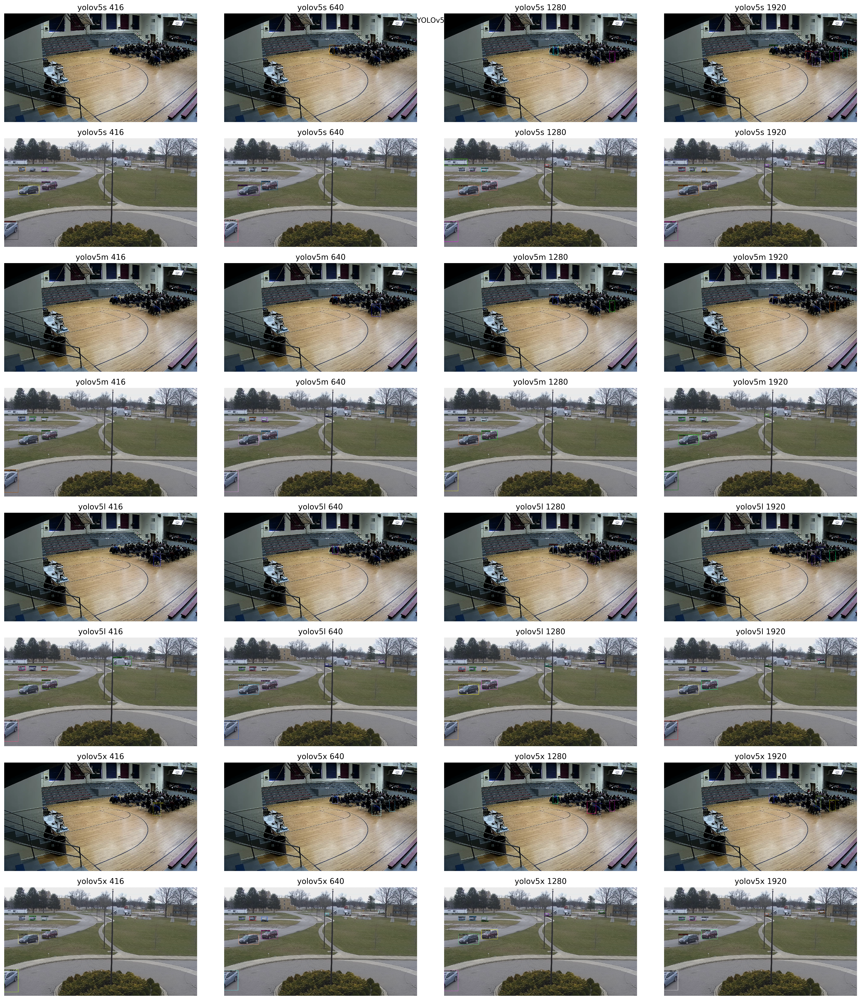

In [4]:
from detectors.yolo_v5 import YoloV5

backbones = ['yolov5s', 'yolov5m', 'yolov5l', 'yolov5x']
input_shapes = [416, 640, 1280, 1920]

n_row = len(backbones) * len(imgs)
n_col = len(input_shapes)
fig, axes = plt.subplots(n_row, n_col, figsize=(n_col * 16 / 3, n_row * 9 / 3), dpi=120)
fig.suptitle('YOLOv5')
fig.set_tight_layout(0.01)
bar = tqdm(total=n_row * n_col)
for i1, backbone in enumerate(backbones):
    model = YoloV5(0, backbone, input_shapes[0])
    for i2, input_shape in enumerate(input_shapes):
        model.model_input_shape = (input_shape, input_shape)
        for i3, img in enumerate(imgs.values()):
            detection = model([img])[0]
            visual_image = visualizer.draw(img, detection, show=False)
            ax = axes[i1 * len(imgs) + i3, i2]
            ax.imshow(visual_image)
            ax.set_title('%s %s' % (backbone, input_shape))
            ax.axis('off')
            bar.update()
bar.close()

In [5]:
outdoor_model = YoloV5(0, 'yolov5l', 640)
outdoor_data = [imgs['test_outdoor.png']] * 8
detections = outdoor_model(outdoor_data)

Using cache found in /home/lijun/.cache/torch/hub/ultralytics_yolov5_master



              from  n    params  module                                  arguments                     
  0             -1  1      7040  models.common.Focus                     [3, 64, 3]                    
  1             -1  1     73984  models.common.Conv                      [64, 128, 3, 2]               
  2             -1  3    246912  models.common.Bottleneck                [128, 128]                    
  3             -1  1    295424  models.common.Conv                      [128, 256, 3, 2]              
  4             -1  1   1627904  models.common.BottleneckCSP             [256, 256, 9]                 
  5             -1  1   1180672  models.common.Conv                      [256, 512, 3, 2]              
  6             -1  1   6499840  models.common.BottleneckCSP             [512, 512, 9]                 
  7             -1  1   4720640  models.common.Conv                      [512, 1024, 3, 2]             
  8             -1  1   2624512  models.common.SPP             

In [6]:
%%timeit
detections = outdoor_model(outdoor_data)

129 ms ± 642 µs per loop (mean ± std. dev. of 7 runs, 10 loops each)


In [7]:
indoor_model = MaskRCNN(0, 'res101', (1920, 1080))
indoor_data = [imgs['test_indoor.png']] * 8
detections = indoor_model(indoor_data)

In [8]:
%%timeit
detections = indoor_model(indoor_data)

1.16 s ± 2.68 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)
